In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, ConcatDataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import pandas as pd
from skimage import io, transform
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm import tqdm
import glob
import gc
from gan_utils import *

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
ngpu = 1
nz = 32
ngf = 64
ndf = 64
nc = 3
mask_sizes = [2,4,8,16,32]
mask_noise = 0
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print('device:', device)

device: cuda:0


In [3]:
df = pd.read_csv('imagenet_flowers/mask_pred_dict_sampled.csv')
files = df['file'].values
image_paths = [os.path.join('imagenet_flowers/flower64', file) for file in files]
mask_paths = [os.path.join('imagenet_flowers/mask_pred64', file) for file in files]
del df
gc.collect()
my_transform = transforms.Compose([transforms.ToTensor(),
                                   transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
realflower = flower_dataset(image_paths, mask_paths,
                            mask_sizes = mask_sizes,
                            transform = my_transform,
                            mask_transform = my_transform,
                            in_memory = True)

image_paths = glob.glob("imagenet_nonflowers/nonflower64/*_1.jpg")
realnonflower = flower_dataset(image_paths,
                               mask_sizes = mask_sizes,
                               transform = my_transform,
                               in_memory = True)

realdata = ConcatDataset([realflower, realnonflower])                               
dataloader = DataLoader(realdata, batch_size=128, shuffle=True, num_workers=1)

0it [00:00, ?it/s]/usr/local/lib/python3.5/dist-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/usr/local/lib/python3.5/dist-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
66766it [42:32, 28.70it/s]
10676it [01:45, 101.36it/s]


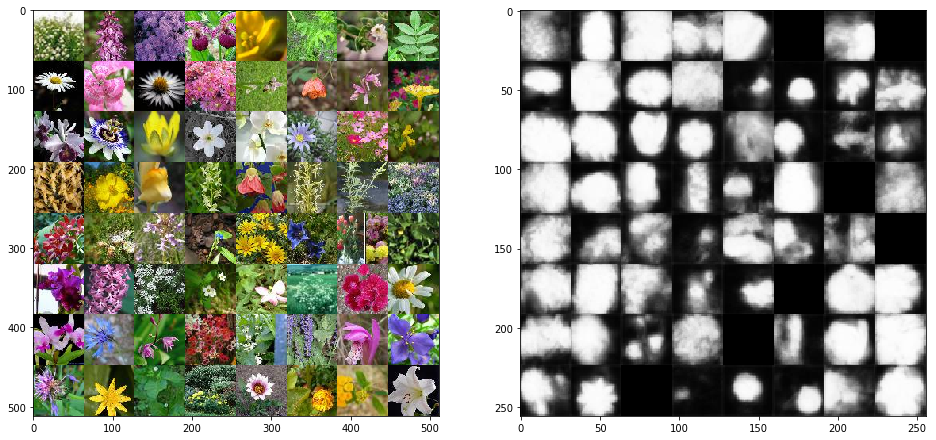

In [4]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(16,8))
plt.axis("off")
plt.title("Training Images")
plt.subplot(1,2,1)
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,2,2)
plt.imshow(np.transpose(vutils.make_grid(real_batch[1][-1].to(device)[:64], padding=0, normalize=True).cpu(),(1,2,0)))
plt.show()

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.layer1 = nn.Sequential(
            # input is Z, going into a convolution
            # input Z(32,2,2)
            nn.ConvTranspose2d(nz + 1, ngf * 8, 4, 2, 0, bias=False),
            nn.ReflectionPad2d(-1),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True)
        )
        self.layer2 = nn.Sequential(
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8 + 1, ngf * 4, 4, 2, 0, bias=False),
            nn.ReflectionPad2d(-1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True)
        )
        self.layer3 = nn.Sequential(
            # state size. (ngf*4) x 8 x 8            
            nn.ConvTranspose2d(ngf * 4 + 1, ngf * 2, 4, 2, 0, bias=False),
            nn.ReflectionPad2d(-1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True)
        )
        self.layer4 = nn.Sequential(
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2 + 1, ngf, 4, 2, 0, bias=False),
            nn.ReflectionPad2d(-1),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True)
        )
        self.layer5 = nn.Sequential(
            # state size. (ngf) x 32 x 32            
            nn.ConvTranspose2d(ngf + 1, nc, 4, 2, 0, bias=False),
            nn.ReflectionPad2d(-1),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, noise, mask):
        x = torch.cat((noise, mask[0]), dim=1) #2*2
        x = self.layer1(x)
        x = torch.cat((x, mask[1]), dim=1) #4*4
        x = self.layer2(x)
        x = torch.cat((x, mask[2]), dim=1) #8*8
        x = self.layer3(x)
        x = torch.cat((x, mask[3]), dim=1) #16*16
        x = self.layer4(x)
        x = torch.cat((x, mask[4]), dim=1) #32*32
        x = self.layer5(x)
        return x
    
    
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)
print("netG parameters:", [p.numel() for p in netG.parameters() if p.requires_grad])

Generator(
  (layer1): Sequential(
    (0): ConvTranspose2d(33, 512, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer2): Sequential(
    (0): ConvTranspose2d(513, 256, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer3): Sequential(
    (0): ConvTranspose2d(257, 128, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace)
  )
  (layer4): Sequential(
    (0): ConvTranspose2d(129, 64, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): ReflectionPad2d((-1, -1, -1, -1))
    (2): BatchNorm2d(64, eps=1e-05, momentum

In [6]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.layer1 = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.layer2 = nn.Sequential(
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf + 1, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.layer3 = nn.Sequential(
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2 + 1, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.layer4 = nn.Sequential(
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4 + 1, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.layer5 = nn.Sequential(
        # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8 + 1, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, image, mask):
        x = self.layer1(image)
        x = torch.cat((x, mask[4]), dim=1) #32*32
        x = self.layer2(x)
        x = torch.cat((x, mask[3]), dim=1) #16*16
        x = self.layer3(x)
        x = torch.cat((x, mask[2]), dim=1) #8*8
        x = self.layer4(x)
        x = torch.cat((x, mask[1]), dim=1) #4*4
        x = self.layer5(x)
        return x
    
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)
print("netD parameters", [p.numel() for p in netD.parameters() if p.requires_grad])

Discriminator(
  (layer1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer2): Sequential(
    (0): Conv2d(65, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer3): Sequential(
    (0): Conv2d(129, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer4): Sequential(
    (0): Conv2d(257, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace)
  )
  (layer5): Sequential(
    (0): Conv2d(513, 1, kernel_size

torch.Size([64, 1, 1, 1])

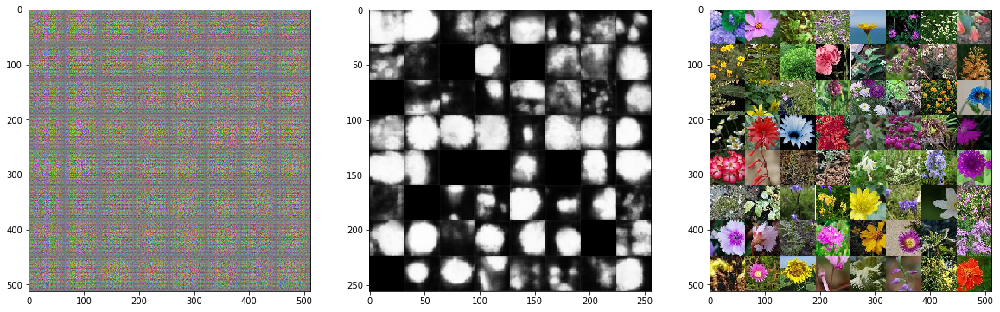

In [7]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 2, 2, device=device)
fixed_mask = [torch.randn(64, 1, size, size, device=device, dtype=torch.float32) * mask_noise for size in mask_sizes]
fixed_image = torch.zeros(64, 3, 64, 64, device=device)
for i in range(64):
    n = np.random.randint(len(realdata))
    for k, mask in enumerate(fixed_mask):
        mask[i,:,:,:] += realdata[n][1][k].to(device)
    fixed_image[i,:,:,:] = realdata[n][0]

fake_image = netG(fixed_noise, fixed_mask)
output = netD(fake_image, fixed_mask)
#show_image_n_mask((fake_image[0].detach().cpu(), mask[0].detach().cpu())), output.cpu()
plt.figure(figsize=(20,6))
plt.subplot(1,3,1)
plt.imshow(np.transpose(vutils.make_grid(fake_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,2)
plt.imshow(np.transpose(vutils.make_grid(fixed_mask[-1].detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,3)
plt.imshow(np.transpose(vutils.make_grid(fixed_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))
output.size()

In [8]:
fixed_mask2 = sample_mask(64, sizes = mask_sizes, realdata=realdata, noise_level=mask_noise, device=device)
labels = mask_pair_to_label(fixed_mask, fixed_mask2, device=device)
labels, labels.mean()

(tensor([0.5737, 0.3278, 0.4287, 0.6722, 0.4048, 0.5972, 0.5768, 0.7434, 0.7180,
         0.8129, 0.2531, 0.4427, 0.8948, 0.7024, 0.8027, 0.7666, 0.5570, 0.6996,
         0.6295, 0.4571, 0.6640, 0.6807, 0.3362, 0.6361, 0.5729, 0.2485, 0.7826,
         0.8824, 0.7401, 0.8378, 0.8072, 0.6330, 0.6790, 0.4849, 0.4141, 0.4530,
         0.7223, 0.0905, 0.5133, 0.7377, 0.7714, 0.9093, 0.3223, 0.7249, 0.7048,
         0.7776, 0.5414, 0.5304, 0.2969, 0.8092, 0.6288, 0.5885, 0.7244, 0.5054,
         0.6849, 0.4600, 0.7546, 0.7237, 0.7710, 0.6521, 0.7010, 0.7385, 0.7770,
         0.8132], device='cuda:0'), tensor(0.6233, device='cuda:0'))

In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
lr = 0.0002
beta1 = 0.5
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop
!mkdir model_checkpoints
!mkdir sample_images
!mkdir sample_images/gan_z22_masks_no_noise

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100
start_epoch= 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_image = data[0].to(device)
        real_mask = [noise_input(x, noise_level=mask_noise, device=device) for x in data[1]]
        #real_cpu = noise_input(data, noise_level=0.2*np.exp(-epoch/100.0), device=device)
        b_size = real_image.size(0)
        label = torch.full((b_size,), real_label, device=device)
        #label = get_label(b_size, real_label, soft=0.2, noise=True, noise_level=0.1, device=device)
        # Forward pass real batch through D
        output = netD(real_image, real_mask).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 2, 2, device=device)
        mask = sample_mask(b_size, sizes=mask_sizes, realdata=realdata, noise_level=mask_noise, device=device)
        # Generate fake image batch with G
        fake_image = netG(noise, mask)
        label.fill_(fake_label)
        #label = get_label(b_size, fake_label, soft=0.2, noise=True, noise_level=0.1, device=device)
        # Classify all fake batch with D
        output = netD(fake_image.detach(), mask).view(-1)
        #print("output1",output[:5])
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label) * (1.5-sigmoid(epoch+start_epoch)) 
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        # Train with real-image and unmatched masks
        label = mask_pair_to_label(mask, real_mask, device=device)
        output = netD(real_image, mask).view(-1)
        errD_unmatch = criterion(output, label) * (sigmoid(epoch+start_epoch)-0.5)
        errD_unmatch.backward()
        D_G_z3 = output.mean().item()
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake + errD_unmatch
        # Update D
        optimizerD.step()
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        #label = get_label(b_size, real_label, soft=0.2, noise=False, device=device)
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake_image, mask).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()        
               
        # Output training stats
        if i % 128 == 0:
            print('[%d/%d][%d/%d]  Loss_D: %.4f (%.4f / %.4f / %.4f). Loss_G: %.4f  D(x): %.4f  D(G(z)): %.4f / %.4f / %.4f'
                  % (epoch-start_epoch, num_epochs, i, len(dataloader),
                     errD.item(), errD_real.item(), errD_fake.item(), errD_unmatch.item(), errG.item(), D_x, D_G_z1, D_G_z2, D_G_z3))
            Dgradnorm_first = list(netD.parameters())[0].grad.norm()
            Ggradnorm_first = list(netG.parameters())[0].grad.norm()
            Ggradnorm_last = list(netG.parameters())[-1].grad.norm()
            print("Ggradnorm first: %.4f\t Ggradnormlast: %.4f\t Dgradnormlast: %.4f"%(Ggradnorm_first, Ggradnorm_last, Dgradnorm_first))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake_image = netG(fixed_noise, fixed_mask).detach().cpu()
            image_tensor = vutils.make_grid(fake_image, padding=2, normalize=True)
            img_list.append(image_tensor)
            filepath = 'sample_images/gan_z22_masks_no_noise/ep'+str(epoch)+'_itr'+str(i)+'.jpg'
            io.imsave(filepath, image_tensor.numpy().transpose(1,2,0))

        iters += 1
        
    if epoch%20==0:
        checkpoint_path = "model_checkpoints/GAN_z22_mask_no_noise_ep"+str(epoch)
        print('save model to %s'%checkpoint_path)
        torch.save({
            'netG_state_dict': netG.state_dict(),
            'netD_state_dict': netD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
            }, checkpoint_path)
        
print('Done')

mkdir: cannot create directory ‘model_checkpoints’: File exists
mkdir: cannot create directory ‘sample_images’: File exists
Starting Training Loop...
[0/100][0/606]  Loss_D: 1.4915 (0.8023 / 0.6892 / 0.0000). Loss_G: 3.7620  D(x): 0.5125  D(G(z)): 0.4539 / 0.4682 / 0.5139
Ggradnorm first: 3.2270	 Ggradnormlast: 5.3785	 Dgradnormlast: 5.6383


/usr/local/lib/python3.5/dist-packages/skimage/util/dtype.py:141: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))


[0/100][128/606]  Loss_D: 0.1822 (0.0490 / 0.1332 / 0.0000). Loss_G: 5.1246  D(x): 0.9551  D(G(z)): 0.1193 / 0.0088 / 0.9308
Ggradnorm first: 1.4166	 Ggradnormlast: 14.8326	 Dgradnormlast: 25.5663
[0/100][256/606]  Loss_D: 0.2239 (0.0831 / 0.1408 / 0.0000). Loss_G: 3.8614  D(x): 0.9262  D(G(z)): 0.1165 / 0.0365 / 0.8820
Ggradnorm first: 1.7033	 Ggradnormlast: 6.3269	 Dgradnormlast: 19.9829
[0/100][384/606]  Loss_D: 1.1533 (0.2350 / 0.9183 / 0.0000). Loss_G: 4.3845  D(x): 0.8336  D(G(z)): 0.4672 / 0.0352 / 0.7210
Ggradnorm first: 3.0152	 Ggradnormlast: 9.5766	 Dgradnormlast: 16.5403
[0/100][512/606]  Loss_D: 0.9192 (0.5919 / 0.3273 / 0.0000). Loss_G: 2.8253  D(x): 0.6116  D(G(z)): 0.2482 / 0.0854 / 0.3569
Ggradnorm first: 2.8760	 Ggradnormlast: 13.5013	 Dgradnormlast: 34.1713
save model to model_checkpoints/GAN_z22_mask_no_noise_ep0
[1/100][0/606]  Loss_D: 1.5062 (1.4250 / 0.0776 / 0.0036). Loss_G: 2.9063  D(x): 0.4663  D(G(z)): 0.0566 / 0.2412 / 0.3525
Ggradnorm first: 2.9020	 Ggradnor

[8/100][384/606]  Loss_D: 0.3265 (0.0257 / 0.2824 / 0.0184). Loss_G: 4.3446  D(x): 0.9748  D(G(z)): 0.2321 / 0.0189 / 0.3681
Ggradnorm first: 5.4883	 Ggradnormlast: 8.1314	 Dgradnormlast: 70.8142
[8/100][512/606]  Loss_D: 0.3673 (0.2979 / 0.0249 / 0.0446). Loss_G: 3.0504  D(x): 0.7637  D(G(z)): 0.0237 / 0.0696 / 0.0461
Ggradnorm first: 5.3292	 Ggradnormlast: 6.9163	 Dgradnormlast: 137.5286
[9/100][0/606]  Loss_D: 5.2555 (0.0021 / 5.2077 / 0.0457). Loss_G: 9.2697  D(x): 0.9979  D(G(z)): 0.9694 / 0.0036 / 0.9695
Ggradnorm first: 6.3307	 Ggradnormlast: 16.8244	 Dgradnormlast: 99.6559
[9/100][128/606]  Loss_D: 0.3082 (0.0779 / 0.2103 / 0.0200). Loss_G: 3.4540  D(x): 0.9271  D(G(z)): 0.1834 / 0.0393 / 0.3617
Ggradnorm first: 5.0564	 Ggradnormlast: 5.7581	 Dgradnormlast: 82.3412
[9/100][256/606]  Loss_D: 0.2847 (0.0597 / 0.1967 / 0.0283). Loss_G: 4.6037  D(x): 0.9436  D(G(z)): 0.1686 / 0.0142 / 0.2082
Ggradnorm first: 6.1709	 Ggradnormlast: 13.0435	 Dgradnormlast: 104.9419
[9/100][384/606]  

[17/100][0/606]  Loss_D: 10.5918 (0.0000 / 10.4173 / 0.1746). Loss_G: 7.7937  D(x): 1.0000  D(G(z)): 0.9999 / 0.0034 / 0.9994
Ggradnorm first: 4.6643	 Ggradnormlast: 14.2487	 Dgradnormlast: 216.6077
[17/100][128/606]  Loss_D: 0.3501 (0.2491 / 0.0254 / 0.0756). Loss_G: 1.8195  D(x): 0.8051  D(G(z)): 0.0255 / 0.2270 / 0.1071
Ggradnorm first: 4.5514	 Ggradnormlast: 11.0322	 Dgradnormlast: 162.4964
[17/100][256/606]  Loss_D: 0.1386 (0.0230 / 0.0765 / 0.0391). Loss_G: 4.5516  D(x): 0.9776  D(G(z)): 0.0722 / 0.0169 / 0.3640
Ggradnorm first: 6.2635	 Ggradnormlast: 19.2365	 Dgradnormlast: 170.2329
[17/100][384/606]  Loss_D: 0.0782 (0.0320 / 0.0149 / 0.0313). Loss_G: 4.6898  D(x): 0.9692  D(G(z)): 0.0153 / 0.0139 / 0.6408
Ggradnorm first: 6.5469	 Ggradnormlast: 16.3041	 Dgradnormlast: 187.6398
[17/100][512/606]  Loss_D: 0.0781 (0.0172 / 0.0230 / 0.0379). Loss_G: 4.1496  D(x): 0.9831  D(G(z)): 0.0235 / 0.0227 / 0.4173
Ggradnorm first: 6.7334	 Ggradnormlast: 27.2456	 Dgradnormlast: 214.3539
[18/1

[25/100][128/606]  Loss_D: 0.1288 (0.0420 / 0.0041 / 0.0827). Loss_G: 4.5409  D(x): 0.9597  D(G(z)): 0.0043 / 0.0158 / 0.1742
Ggradnorm first: 6.4070	 Ggradnormlast: 15.9152	 Dgradnormlast: 265.3666
[25/100][256/606]  Loss_D: 0.1042 (0.0051 / 0.0170 / 0.0821). Loss_G: 4.3783  D(x): 0.9950  D(G(z)): 0.0178 / 0.0227 / 0.1816
Ggradnorm first: 6.2421	 Ggradnormlast: 33.6953	 Dgradnormlast: 266.5534
[25/100][384/606]  Loss_D: 0.1016 (0.0012 / 0.0280 / 0.0724). Loss_G: 3.5424  D(x): 0.9988  D(G(z)): 0.0289 / 0.0398 / 0.2392
Ggradnorm first: 5.6758	 Ggradnormlast: 29.1829	 Dgradnormlast: 292.0910
[25/100][512/606]  Loss_D: 0.1471 (0.0035 / 0.0034 / 0.1402). Loss_G: 4.4536  D(x): 0.9965  D(G(z)): 0.0036 / 0.0178 / 0.0377
Ggradnorm first: 5.5207	 Ggradnormlast: 20.0702	 Dgradnormlast: 274.2161
[26/100][0/606]  Loss_D: 0.8122 (0.0000 / 0.7341 / 0.0781). Loss_G: 11.3728  D(x): 1.0000  D(G(z)): 0.4689 / 0.0000 / 0.9363
Ggradnorm first: 5.0743	 Ggradnormlast: 41.8888	 Dgradnormlast: 337.3533
[26/10

[33/100][384/606]  Loss_D: 0.1923 (0.0006 / 0.1262 / 0.0654). Loss_G: 7.2422  D(x): 0.9994  D(G(z)): 0.1222 / 0.0010 / 0.4266
Ggradnorm first: 5.6038	 Ggradnormlast: 16.0461	 Dgradnormlast: 329.1959
[33/100][512/606]  Loss_D: 0.0797 (0.0001 / 0.0219 / 0.0576). Loss_G: 4.4409  D(x): 0.9999  D(G(z)): 0.0233 / 0.0181 / 0.5801
Ggradnorm first: 5.7533	 Ggradnormlast: 14.9146	 Dgradnormlast: 215.9253
[34/100][0/606]  Loss_D: 0.1311 (0.0006 / 0.0009 / 0.1296). Loss_G: 5.5964  D(x): 0.9994  D(G(z)): 0.0010 / 0.0052 / 0.1217
Ggradnorm first: 6.0636	 Ggradnormlast: 39.6649	 Dgradnormlast: 317.7369
[34/100][128/606]  Loss_D: 0.0752 (0.0001 / 0.0169 / 0.0583). Loss_G: 3.9460  D(x): 0.9999  D(G(z)): 0.0181 / 0.0266 / 0.5303
Ggradnorm first: 5.6532	 Ggradnormlast: 40.1784	 Dgradnormlast: 246.2946
[34/100][256/606]  Loss_D: 0.0968 (0.0004 / 0.0157 / 0.0807). Loss_G: 4.5032  D(x): 0.9996  D(G(z)): 0.0169 / 0.0146 / 0.3122
Ggradnorm first: 5.9750	 Ggradnormlast: 24.4590	 Dgradnormlast: 254.1371
[34/100

[41/100][512/606]  Loss_D: 0.0812 (0.0000 / 0.0073 / 0.0740). Loss_G: 4.7313  D(x): 1.0000  D(G(z)): 0.0080 / 0.0121 / 0.4608
Ggradnorm first: 5.3065	 Ggradnormlast: 22.6230	 Dgradnormlast: 252.9479
[42/100][0/606]  Loss_D: 3.6110 (0.0024 / 3.3478 / 0.2609). Loss_G: 12.2163  D(x): 0.9977  D(G(z)): 0.6684 / 0.0013 / 0.7422
Ggradnorm first: 4.3845	 Ggradnormlast: 10.4623	 Dgradnormlast: 84.6979
[42/100][128/606]  Loss_D: 0.2154 (0.0119 / 0.0260 / 0.1775). Loss_G: 4.0651  D(x): 0.9883  D(G(z)): 0.0280 / 0.0277 / 0.1010
Ggradnorm first: 4.7994	 Ggradnormlast: 7.6980	 Dgradnormlast: 52.2804
[42/100][256/606]  Loss_D: 0.1003 (0.0028 / 0.0190 / 0.0785). Loss_G: 5.0233  D(x): 0.9972  D(G(z)): 0.0207 / 0.0103 / 0.5011
Ggradnorm first: 5.5000	 Ggradnormlast: 11.5122	 Dgradnormlast: 95.1297
[42/100][384/606]  Loss_D: 0.2083 (0.0075 / 0.0740 / 0.1268). Loss_G: 3.6050  D(x): 0.9925  D(G(z)): 0.0768 / 0.0366 / 0.1899
Ggradnorm first: 4.7592	 Ggradnormlast: 10.6060	 Dgradnormlast: 101.2253
[42/100][5

[50/100][128/606]  Loss_D: 0.1546 (0.0205 / 0.0062 / 0.1280). Loss_G: 3.8925  D(x): 0.9801  D(G(z)): 0.0070 / 0.0290 / 0.2907
Ggradnorm first: 5.3789	 Ggradnormlast: 23.6525	 Dgradnormlast: 297.4981
[50/100][256/606]  Loss_D: 0.1083 (0.0004 / 0.0223 / 0.0856). Loss_G: 4.8697  D(x): 0.9996  D(G(z)): 0.0248 / 0.0111 / 0.5496
Ggradnorm first: 5.7085	 Ggradnormlast: 21.4933	 Dgradnormlast: 188.4012
[50/100][384/606]  Loss_D: 0.1177 (0.0005 / 0.0031 / 0.1141). Loss_G: 4.9291  D(x): 0.9995  D(G(z)): 0.0035 / 0.0112 / 0.3182
Ggradnorm first: 5.8782	 Ggradnormlast: 107.1270	 Dgradnormlast: 182.2500
[50/100][512/606]  Loss_D: 0.0991 (0.0002 / 0.0137 / 0.0852). Loss_G: 5.4860  D(x): 0.9998  D(G(z)): 0.0153 / 0.0066 / 0.5797
Ggradnorm first: 6.2257	 Ggradnormlast: 53.3019	 Dgradnormlast: 196.3572
[51/100][0/606]  Loss_D: 10.5969 (0.0000 / 9.9122 / 0.6847). Loss_G: 11.8763  D(x): 1.0000  D(G(z)): 0.9999 / 0.0001 / 1.0000
Ggradnorm first: 3.9789	 Ggradnormlast: 17.4763	 Dgradnormlast: 184.7724
[51/

[58/100][384/606]  Loss_D: 0.1063 (0.0001 / 0.0060 / 0.1001). Loss_G: 5.5227  D(x): 0.9999  D(G(z)): 0.0069 / 0.0056 / 0.4853
Ggradnorm first: 5.4797	 Ggradnormlast: 21.6105	 Dgradnormlast: 171.1647
[58/100][512/606]  Loss_D: 0.1011 (0.0000 / 0.0042 / 0.0969). Loss_G: 5.9203  D(x): 1.0000  D(G(z)): 0.0049 / 0.0037 / 0.5760
Ggradnorm first: 5.3316	 Ggradnormlast: 46.8328	 Dgradnormlast: 177.0291
[59/100][0/606]  Loss_D: 0.1830 (0.0000 / 0.0502 / 0.1327). Loss_G: 7.3221  D(x): 1.0000  D(G(z)): 0.0560 / 0.0009 / 0.8634
Ggradnorm first: 5.0432	 Ggradnormlast: 51.6533	 Dgradnormlast: 153.1138
[59/100][128/606]  Loss_D: 0.1045 (0.0000 / 0.0065 / 0.0981). Loss_G: 6.7972  D(x): 1.0000  D(G(z)): 0.0075 / 0.0016 / 0.7274
Ggradnorm first: 6.0757	 Ggradnormlast: 38.9596	 Dgradnormlast: 168.6204
[59/100][256/606]  Loss_D: 0.1772 (0.0000 / 0.0337 / 0.1434). Loss_G: 6.7671  D(x): 1.0000  D(G(z)): 0.0380 / 0.0016 / 0.8971
Ggradnorm first: 5.0370	 Ggradnormlast: 18.3375	 Dgradnormlast: 187.1715
[59/100

[66/100][512/606]  Loss_D: 0.1160 (0.0000 / 0.0045 / 0.1115). Loss_G: 4.6180  D(x): 1.0000  D(G(z)): 0.0054 / 0.0143 / 0.5127
Ggradnorm first: 5.3636	 Ggradnormlast: 71.6177	 Dgradnormlast: 157.0662
[67/100][0/606]  Loss_D: 2.1118 (0.0000 / 1.8276 / 0.2842). Loss_G: 17.3774  D(x): 1.0000  D(G(z)): 0.7817 / 0.0000 / 0.9809
Ggradnorm first: 3.5706	 Ggradnormlast: 34.7215	 Dgradnormlast: 274.7940
[67/100][128/606]  Loss_D: 0.2262 (0.0005 / 0.0621 / 0.1636). Loss_G: 3.5366  D(x): 0.9995  D(G(z)): 0.0697 / 0.0368 / 0.2558
Ggradnorm first: 3.1756	 Ggradnormlast: 6.0643	 Dgradnormlast: 43.8898
[67/100][256/606]  Loss_D: 0.1164 (0.0002 / 0.0071 / 0.1091). Loss_G: 5.4115  D(x): 0.9998  D(G(z)): 0.0083 / 0.0060 / 0.5929
Ggradnorm first: 4.8431	 Ggradnormlast: 17.9048	 Dgradnormlast: 133.5494
[67/100][384/606]  Loss_D: 0.1236 (0.0042 / 0.0113 / 0.1080). Loss_G: 6.0000  D(x): 0.9958  D(G(z)): 0.0133 / 0.0035 / 0.6089
Ggradnorm first: 5.4872	 Ggradnormlast: 13.2870	 Dgradnormlast: 129.2963
[67/100]

Process Process-72:
Traceback (most recent call last):
  File "/usr/lib/python3.5/multiprocessing/process.py", line 249, in _bootstrap
    self.run()
  File "/usr/lib/python3.5/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.5/dist-packages/torch/utils/data/dataloader.py", line 96, in _worker_loop
    r = index_queue.get(timeout=MANAGER_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.5/multiprocessing/queues.py", line 104, in get
    if timeout < 0 or not self._poll(timeout):
  File "/usr/lib/python3.5/multiprocessing/connection.py", line 257, in poll
    return self._poll(timeout)
  File "/usr/lib/python3.5/multiprocessing/connection.py", line 414, in _poll
    r = wait([self], timeout)
  File "/usr/lib/python3.5/multiprocessing/connection.py", line 911, in wait
    ready = selector.select(timeout)
  File "/usr/lib/python3.5/selectors.py", line 376, in select
    fd_event_list = self._poll.poll(timeout)
Keyboard

KeyboardInterrupt: 

Animation size has reached 21437302 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


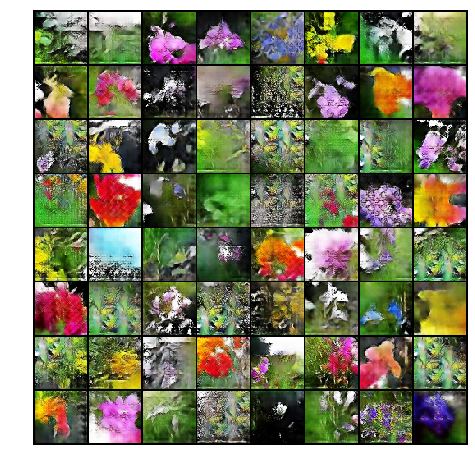

In [11]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

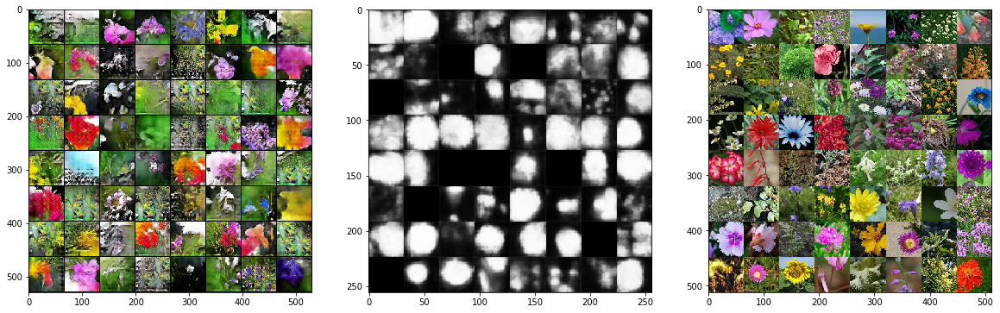

In [12]:
plt.figure(figsize=(20,8))
plt.subplot(1,3,1)
plt.imshow(np.transpose(vutils.make_grid(img_list[-1], padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,2)
plt.imshow(np.transpose(vutils.make_grid(fixed_mask[-1].detach(), padding=0, normalize=True).cpu(),(1,2,0)))
plt.subplot(1,3,3)
plt.imshow(np.transpose(vutils.make_grid(fixed_image.detach(), padding=0, normalize=True).cpu(),(1,2,0)))

In [13]:
torch.save({
            'netG_state_dict': netG.state_dict(),
            'netD_state_dict': netD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
            }, "model_checkpoints/GAN_z22_mask_no_noise")